In [1]:
!pip install numpy
!pip install matplotlib
!pip install opencv-python
!pip install open3d
!pip install ultralytics
!pip install statistics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 3.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 77.1 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.0/215.0 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 58.3 MB/s eta 0:00:00:00:01
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: jupyterlab-widgets
    Found existing installation: jupyterlab-widgets 3.0.9
    Uninstalling jupyterlab-widgets-3.0.9:
      Successfully uninstalled jupyterlab-widgets-3.0.9
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1
     ━━━

##0 - Load the Data and Visualize it!

### Link Google Colab to Google Drive

### Import the necessary libraries

In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import open3d as o3d

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


### Load the Files

In [3]:
! pwd

/kaggle/working


In [4]:
image_files = sorted(glob.glob("/kaggle/input/dataset/data/img/*.png"))
point_files = sorted(glob.glob("/kaggle/input/dataset/data/velodyne/*.pcd"))
label_files = sorted(glob.glob("/kaggle/input/dataset/data/label/*.txt"))
calib_files = sorted(glob.glob("/kaggle/input/dataset/data/calib/*.txt"))

index = 0
pcd_file = point_files[index]
image = cv2.cvtColor(cv2.imread(image_files[index]), cv2.COLOR_BGR2RGB)
cloud = o3d.io.read_point_cloud(pcd_file)
points= np.asarray(cloud.points)

In [5]:
points.shape

(121291, 3)

In [6]:
new_points = np.zeros((points.shape[0], 6))

# Copy the first 3 columns from 'points' to the first 3 columns of 'new_points'
new_points[:, :3] = points


In [7]:
new_points[0]

array([21.75099945,  2.53399992,  0.94999999,  0.        ,  0.        ,
        0.        ])

### Visualize the Image

Text(0.5, 1.0, 'Image')

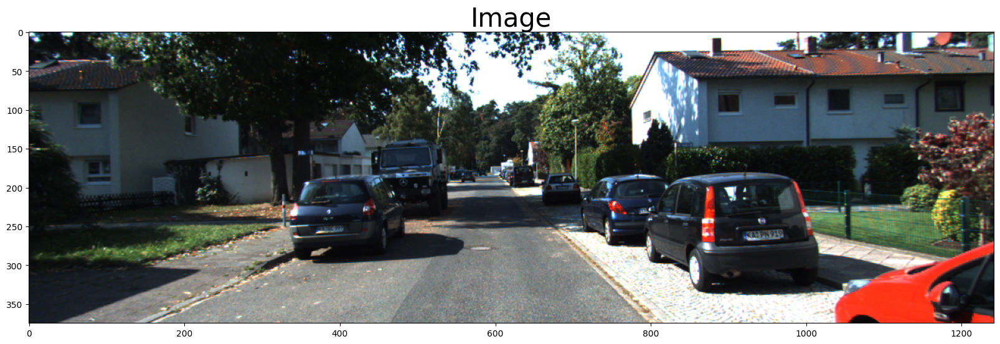

In [8]:
f, (ax1) = plt.subplots(1, 1, figsize=(20,10))
ax1.imshow(image)
ax1.set_title('Image', fontsize=30)

### Visualize the Point Clouds

### What We Need to Do:

1. *Select Visible Points:* We need to identify which points are visible within the image.
2. *Convert Points:* Transform points from the LiDAR frame to the Camera Frame.
3. *Project to Image:* Find a method to project points from the Camera Frame to the Image Frame.


### Code Implementation

For our purpose, we're particularly interested in:

- *Velo-To-Cam (V2C):* Rotation and translation matrices from Velodyne to the Left Grayscale camera.
- *R0_rect:* Used in Stereo Vision to make images co-planar.
- *P2:* Matrix obtained after camera calibration, containing the intrinsic matrix K and extrinsic parameters.


Not all details are essential for our task, but understanding these parameters is crucial for accurate projection

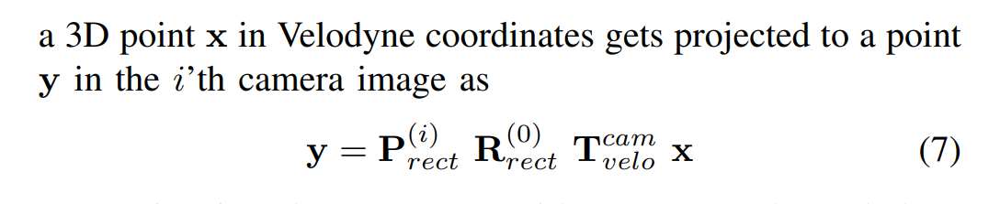

Calibiration File was in Following Format

P0

P1

P2

P3

R0_rect

Tr_velo_to_cam

Tr_imu_to_velo

In [9]:
class LiDAR2Camera(object):
    def __init__(self, calib_file):
        calibs = self.read_calib_file(calib_file)
        P = calibs["P2"]
        self.P = np.reshape(P, [3, 4])
        # Rigid transform from Velodyne coord to reference camera coord
        V2C = calibs["Tr_velo_to_cam"]
        self.V2C = np.reshape(V2C, [3, 4])
        # Rotation from reference camera coord to rect camera coord
        R0 = calibs["R0_rect"]
        self.R0 = np.reshape(R0, [3, 3])

    def read_calib_file(self, filepath):
        """ Read in a calibration file and parse into a dictionary.
        Ref: https://github.com/utiasSTARS/pykitti/blob/master/pykitti/utils.py
        """
        data = {}
        with open(filepath, "r") as f:
            for line in f.readlines():
                line = line.rstrip()
                if len(line) == 0:
                    continue
                key, value = line.split(":", 1)
                # The only non-float values in these files are dates, which
                # we don't care about anyway
                try:
                    data[key] = np.array([float(x) for x in value.split()])
                except ValueError:
                    pass
        return data
    def cart2hom(self, pts_3d):
        """ Input: nx3 points in Cartesian
            Oupput: nx4 points in Homogeneous by pending 1
        """
        n = pts_3d.shape[0]
        pts_3d_hom = np.hstack((pts_3d, np.ones((n, 1))))
        return pts_3d_hom

    def project_velo_to_ref(self, pts_3d_velo):
        pts_3d_velo = self.cart2hom(pts_3d_velo)  # nx4
        return np.dot(pts_3d_velo, np.transpose(self.V2C))


    def project_velo_to_image(self, pts_3d_velo):
        '''
        Input: 3D points in Velodyne Frame [nx3]
        Output: 2D Pixels in Image Frame [nx2]
        '''
        # REVERSE TECHNIQUE
        '''
        homogeneous = self.cart2hom(pts_3d_velo)  # nx4
        dotted_RT = np.dot(homogeneous, np.transpose(self.V2C)) #nx3
        dotted_with_RO = np.transpose(np.dot(self.R0, np.transpose(dotted_RT))) #nx3
        homogeneous_2 = self.cart2hom(dotted_with_RO) #nx4
        pts_2d = np.dot(homogeneous_2, np.transpose(self.P))  # nx3
        '''

        # NORMAL TECHNIQUE
        R0_homo = np.vstack([self.R0, [0, 0, 0]])
        R0_homo_2 = np.column_stack([R0_homo, [0, 0, 0, 1]])
        p_r0 = np.dot(self.P, R0_homo_2) #PxR0
        p_r0_rt =  np.dot(p_r0, np.vstack((self.V2C, [0, 0, 0, 1]))) #PxROxRT
        pts_3d_homo = np.column_stack([pts_3d_velo, np.ones((pts_3d_velo.shape[0],1))])
        p_r0_rt_x = np.dot(p_r0_rt, np.transpose(pts_3d_homo))#PxROxRTxX
        pts_2d = np.transpose(p_r0_rt_x)

        pts_2d[:, 0] /= pts_2d[:, 2]
        pts_2d[:, 1] /= pts_2d[:, 2]

        self.pts_2d = pts_2d
        return pts_2d[:, 0:2]

    def get_lidar_in_image_fov(self,pc_velo, xmin, ymin, xmax, ymax, return_more=False, clip_distance=2.0):
          """ Filter lidar points, keep those in image FOV """
          pts_2d = self.project_velo_to_image(pc_velo)
          fov_inds = (
              (pts_2d[:, 0] < xmax)
              & (pts_2d[:, 0] >= xmin)
              & (pts_2d[:, 1] < ymax)
              & (pts_2d[:, 1] >= ymin)
          )
          fov_inds = fov_inds & (pc_velo[:, 0] > clip_distance) # We don't want things that are closer to the clip distance (2m)
          imgfov_pc_velo = pc_velo[fov_inds, :]

          self.fov_inds = fov_inds
          if return_more:
              return imgfov_pc_velo, pts_2d, fov_inds
          else:
              return imgfov_pc_velo



    def show_lidar_on_image(self, pc_velo, img, debug="False"):
          """ Project LiDAR points to image """
          imgfov_pc_velo, pts_2d, fov_inds = self.get_lidar_in_image_fov(
              pc_velo, 0, 0, img.shape[1], img.shape[0], True
          )
          if (debug==True):
              print("3D PC Velo "+ str(imgfov_pc_velo)) # The 3D point Cloud Coordinates
              print("2D PIXEL: " + str(pts_2d)) # The 2D Pixels
              print("FOV : "+str(fov_inds)) # Whether the Pixel is in the image or not
          self.imgfov_pts_2d = pts_2d[fov_inds, :]
          '''
          #homogeneous = np.hstack((imgfov_pc_velo, np.ones((imgfov_pc_velo.shape[0], 1))))
          homogeneous = self.cart2hom(imgfov_pc_velo)
          transposed_RT = np.dot(homogeneous, np.transpose(self.V2C))
          dotted_RO = np.transpose(np.dot(self.R0, np.transpose(transposed_RT)))
          self.imgfov_pc_rect = dotted_RO

          if debug==True:
              print("FOV PC Rect "+ str(self.imgfov_pc_rect))
          '''
          cmap = plt.cm.get_cmap("hsv", 256)
          cmap = np.array([cmap(i) for i in range(256)])[:, :3] * 255
          self.imgfov_pc_velo = imgfov_pc_velo

          for i in range(self.imgfov_pts_2d.shape[0]):
              #depth = self.imgfov_pc_rect[i,2]
              #print(depth)
              depth = imgfov_pc_velo[i,0]
              #print(depth)
              color = cmap[int(510.0 / depth), :]
              cv2.circle(
                  img,(int(np.round(self.imgfov_pts_2d[i, 0])), int(np.round(self.imgfov_pts_2d[i, 1]))),2,
                  color=tuple(color),
                  thickness=-1,
              )

          return img



In [10]:
lidar2cam = LiDAR2Camera(calib_files[index])
print("P :"+str(lidar2cam.P))
print("-")
print("RO "+str(lidar2cam.R0))
print("-")
print("Velo 2 Cam " +str(lidar2cam.V2C))
print("-")
#print("Cam 2 Velo" + str(lidar2cam.C2V))

P :[[7.215377e+02 0.000000e+00 6.095593e+02 4.485728e+01]
 [0.000000e+00 7.215377e+02 1.728540e+02 2.163791e-01]
 [0.000000e+00 0.000000e+00 1.000000e+00 2.745884e-03]]
-
RO [[ 0.9999239   0.00983776 -0.00744505]
 [-0.0098698   0.9999421  -0.00427846]
 [ 0.00740253  0.00435161  0.9999631 ]]
-
Velo 2 Cam [[ 7.533745e-03 -9.999714e-01 -6.166020e-04 -4.069766e-03]
 [ 1.480249e-02  7.280733e-04 -9.998902e-01 -7.631618e-02]
 [ 9.998621e-01  7.523790e-03  1.480755e-02 -2.717806e-01]]
-


In [11]:
R0_homo = np.vstack([lidar2cam.R0, [0, 0, 0]])
R0_homo_2 = np.column_stack([R0_homo, [0, 0, 0, 1]])
R0_homo_2

array([[ 0.9999239 ,  0.00983776, -0.00744505,  0.        ],
       [-0.0098698 ,  0.9999421 , -0.00427846,  0.        ],
       [ 0.00740253,  0.00435161,  0.9999631 ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [12]:
V2Ch = np.vstack((lidar2cam.V2C, [0, 0, 0, 1]))
V2Ch

array([[ 7.533745e-03, -9.999714e-01, -6.166020e-04, -4.069766e-03],
       [ 1.480249e-02,  7.280733e-04, -9.998902e-01, -7.631618e-02],
       [ 9.998621e-01,  7.523790e-03,  1.480755e-02, -2.717806e-01],
       [ 0.000000e+00,  0.000000e+00,  0.000000e+00,  1.000000e+00]])

In [13]:

print(points[:1,:])
print(lidar2cam.project_velo_to_ref(points[:1,:]))


[[21.75099945  2.53399992  0.94999999]]
[[-2.3747165  -0.70239797 21.50935184]]


In [14]:

print(points[:1,:3])
print("Euclidean Pixels "+str(lidar2cam.project_velo_to_image(points[:1,:3])))


[[21.75099945  2.53399992  0.94999999]]
Euclidean Pixels [[526.23638509 146.95787607]]


### 1.4 - LiDAR in Image Field Of View

###1.5 -- Get the LiDAR Points in Pixels

In [15]:
image.shape

(375, 1242, 3)

/tmp/ipykernel_33/1448053021.py:113: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap("hsv", 256)


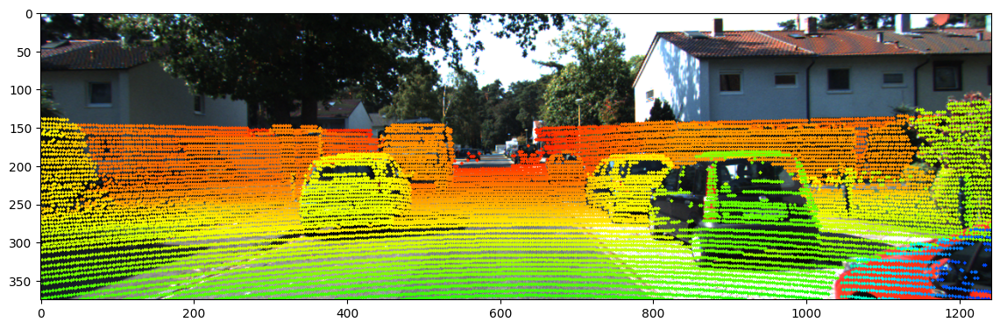

In [16]:
#img_3 = lidar2cam.show_lidar_on_image(points[:,:3], image)
img_3 = image.copy()
img_3 = lidar2cam.show_lidar_on_image(points[:,:3], img_3)
plt.figure(figsize=(14,7))
plt.imshow(img_3)
plt.show()

In [17]:
imgfov_pc_velo, pts_2d, fov_inds = lidar2cam.get_lidar_in_image_fov(
              points[: , :3], 0, 0, img_3.shape[1], img_3.shape[0], True
          )

In [18]:
fov_inds

array([ True,  True,  True, ..., False, False, False])

In [19]:
imgfov_pc_velo.shape

(18896, 3)

## 2 - Detect Obstacles in 2D

100%|██████████| 21.5M/21.5M [00:00<00:00, 200MB/s]



0: 224x640 5 cars, 1 truck, 297.7ms
Speed: 7.1ms preprocess, 297.7ms inference, 2852.7ms postprocess per image at shape (1, 3, 224, 640)


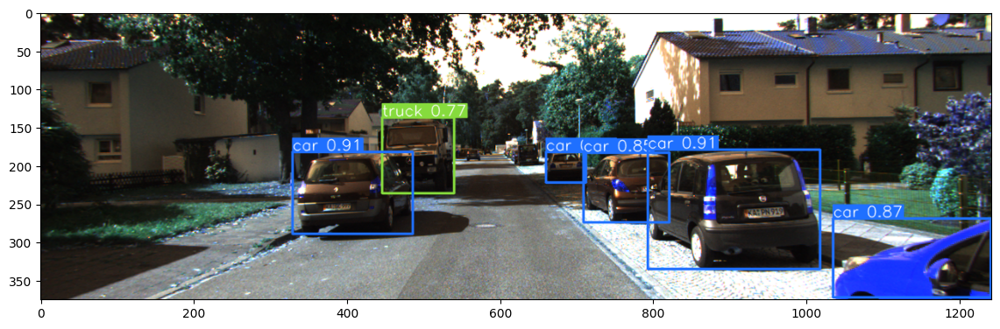

In [20]:
from ultralytics import YOLO
import time
model = YOLO('yolov8s.pt')
def run_obstacle_detection(img):
    start_time=time.time()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    predictions = model(img ,conf = 0.5,classes = [1,2,7])
    for r in predictions:
        pred_bboxes = (r.boxes.data).detach().cpu().numpy()
        result = r.plot()
    return result,pred_bboxes
result, pred_bboxes = run_obstacle_detection(image)

fig_camera = plt.figure(figsize=(14, 7))
ax_lidar = fig_camera.subplots()
ax_lidar.imshow(result)
plt.show()

In [21]:
import cv2
import numpy as np
from PIL import Image

def draw_boxes_cv(img, detections):
    # Open the image only if it's a path
    if isinstance(img, str):
        img = cv2.imread(img)
    # Convert PIL Image to numpy array if necessary
    elif isinstance(img, Image.Image):
        img = np.array(img)

    # Assuming class 2 is 'car'
    class_labels = {2: 'car'}

    # Loop through detections and draw each as a rectangle
    for detection in detections:
        x1, y1, x2, y2, confidence, class_id = detection
        # Draw rectangle
        cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)

        # Prepare text for class label and confidence
        label = f"{class_labels.get(class_id, str(class_id))}: {confidence:.2f}"
        # Calculate text width & height to draw the transparent boxes as background
        (w, h), _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 1)

        # Draw background rectangle for text
        cv2.rectangle(img, (int(x1), int(y1) - 20), (int(x1) + w, int(y1) - 20 + h), (0, 255, 0), -1)
        # Put text above rectangle
        cv2.putText(img, label, (int(x1), int(y1) - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 0), 1)

    # Convert back to PIL Image before returning, if needed
    img_pil = Image.fromarray(img)
    return img_pil

    #plt.axis('off')  # Hide the axis
   # plt.show()


## 3 - Fuse Points Clouds & Bounding Boxes

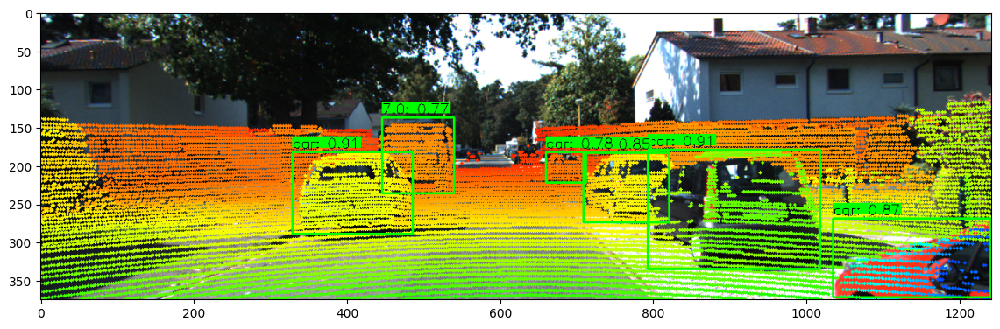

In [22]:
lidar_img_with_bboxes= draw_boxes_cv(img_3, pred_bboxes)
fig_fusion = plt.figure(figsize=(14, 7))
ax_fusion = fig_fusion.subplots()
ax_fusion.imshow(lidar_img_with_bboxes)
plt.show()

In [23]:
def rectContains(rect, pt,w, h, shrink_factor=0):
    # Calculate the new corners of the rectangle after applying the shrink factor
    x1 = rect[0] + (rect[2] - rect[0]) * shrink_factor
    y1 = rect[1] + (rect[3] - rect[1]) * shrink_factor
    x2 = rect[2] - (rect[2] - rect[0]) * shrink_factor
    y2 = rect[3] - (rect[3] - rect[1]) * shrink_factor

    # Check if the point is within the shrunk rectangle
    return x1 < pt[0] < x2 and y1 < pt[1] < y2


In [24]:
import statistics
import random

def filter_outliers(distances):
    inliers = []
    mu  = statistics.mean(distances)
    std = statistics.stdev(distances)
    for x in distances:
        if abs(x-mu) < std:
            # This is an INLIER
            inliers.append(x)
    return inliers

def get_best_distance(distances, technique="closest"):
    if technique == "closest":
        return min(distances)
    elif technique =="average":
        return statistics.mean(distances)
    elif technique == "random":
        return random.choice(distances)
    else:
        return statistics.median(sorted(distances))

In [25]:
def lidar_camera_fusion(self, pred_bboxes, image):
    img_bis = image.copy()

    cmap = plt.cm.get_cmap("hsv", 256)
    cmap = np.array([cmap(i) for i in range(256)])[:, :3] * 255
    distances = []
    for box in pred_bboxes:
        confidence = box[4]
        classid = box[5]
        distances = []

        for i in range(self.pts_2d.shape[0]):
            if(self.fov_inds[i]):
              #depth = self.imgfov_pc_rect[i, 2]
              depth = points[i,0]
              if (rectContains(box, self.pts_2d[i], image.shape[1], image.shape[0], shrink_factor=0.1)==True):
                  distances.append(depth)
                  new_points[i][3] = 1
                  new_points[i][4] = classid
                  new_points[i][5] = confidence

                  color = cmap[int(510.0 / depth), :]

                  cv2.circle(img_bis,(int(np.round(self.pts_2d[i, 0])), int(np.round(self.pts_2d[i, 1]))),2,color=tuple(color),thickness=-1,)

        h, w, _ = img_bis.shape
        if len(distances) >2:
            distances = filter_outliers(distances)
            best_distance = get_best_distance(distances, technique="average")
            cv2.putText(img_bis, f"{round(best_distance,2)}", (int(box[0]+((box[2]-box[0])/2)),(int(box[1]+((box[3]-box[1])/2)))), cv2.FONT_HERSHEY_SIMPLEX, 0.50, (128, 0, 128), 2, cv2.LINE_AA)
        distances_to_keep = []

    return img_bis, distances

LiDAR2Camera.lidar_camera_fusion = lidar_camera_fusion

/tmp/ipykernel_33/4119229444.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap("hsv", 256)


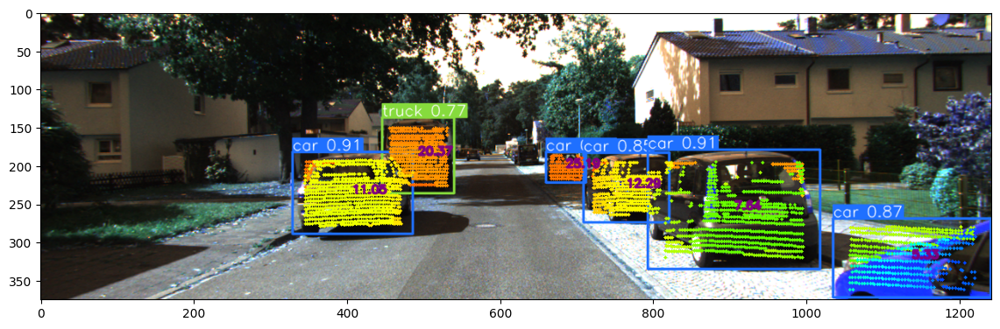

In [26]:
final_result, _ = lidar2cam.lidar_camera_fusion(pred_bboxes, result)

fig_keeping = plt.figure(figsize=(14, 7))
ax_keeping = fig_keeping.subplots()
ax_keeping.imshow(final_result)
plt.show()

In [27]:
for i in range (new_points.shape[0]):
  if(new_points[i][3]):
    print(new_points[i])
    break

[     20.712        2.29       0.781           1           7      0.7747]


In [28]:
import plotly.graph_objs as go

x = new_points[:, 0]
y = new_points[:, 1]
z = new_points[:, 2]
color_value = new_points[:, 3]

fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=1,  # Adjust the marker size to make the dots finer
        color=color_value,  # Color by the third index value
        colorscale='Viridis',  # Choose colormap
        opacity=0.8
    )
)])

# Update layout for better visualization
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        aspectmode='manual',
        aspectratio=dict(x=1, y=1, z=0.5)
    ),
    margin=dict(r=0, l=0, b=0, t=0)
)

# Show plot
fig.show()


In [29]:
import numpy as np
import open3d as o3d

# Step 1: Read the Point Cloud
lidar_file_path = "/kaggle/input/dataset/data/velodyne/000031.bin"  # Update with your file path
points = np.fromfile(lidar_file_path, dtype=np.float32).reshape(-1, 4)
point_cloud = o3d.geometry.PointCloud()
point_cloud.points = o3d.utility.Vector3dVector(points[:, :3])  # Extract XYZ coordinates

# Step 2: Visualize the Point Cloud
o3d.visualization.draw_plotly([point_cloud])


In [30]:
import os
import numpy as np
import struct
import open3d

def read_bin_velodyne(path):
    pc_list = []
    with open(path, 'rb') as f:
        content = f.read()
        pc_iter = struct.iter_unpack('ffff', content)
        for idx, point in enumerate(pc_iter):
            pc_list.append([point[0], point[1], point[2]])
    return np.asarray(pc_list, dtype=np.float32)

def main():
    root_dir = '/kaggle/input/dataset/data/velodyne/'
    filenames = os.listdir(root_dir)
    point_clouds = []

    for filename in filenames:
        path = os.path.join(root_dir, filename)
        print("Processing:", path)
    
        example = read_bin_velodyne(path)
        point_cloud = open3d.geometry.PointCloud()
        point_cloud.points = open3d.utility.Vector3dVector(example)
        point_clouds.append(point_cloud)

    # Visualize all point clouds together
    open3d.visualization.draw_geometries(point_clouds)





In [31]:
import numpy as np


# Save points to a binary file
output_file = "modified_points.bin"
new_points.tofile(output_file)

print("Modified points saved to:", output_file)


Modified points saved to: modified_points.bin


In [32]:
points[0]

array([     21.751,       2.534,        0.95,        0.42], dtype=float32)

In [33]:
file_path = '/kaggle/working/my_array.npy'

# Save the array to file
np.save(file_path, new_points)